#Импортируем библиотеки

Ссылка на датасет: https://www.kaggle.com/arnaud58/horse2zebra

In [32]:
import torch
from torch.utils.data import Dataset, DataLoader
import glob
import os
from PIL import Image 
import cv2
from torchvision import transforms 
from cv2_plt_imshow import cv2_plt_imshow as imshow
from matplotlib.pyplot import imshow as imshow2
import matplotlib.pyplot as plt
import numpy as np
from torchvision.utils import make_grid
import torch.nn as nn
import torch.nn.functional as F
import string
import numpy as np
import glob
import random
import os
from skimage import io
from pathlib import Path
import itertools
import time
from tqdm import tqdm

In [33]:
torch.cuda.is_available()

True

In [34]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

In [35]:
%cd C:\Users\Michel\DataspellProjects\dls_1sem_project

C:\Users\Michel\DataspellProjects\dls_1sem_project


#Разбиваем на папки 

In [36]:
DIR = 'C:/Users/Michel/DataspellProjects/dls_1sem_project'

In [ ]:
os.makedirs(DIR+'/A/train')
os.makedirs(DIR+'/A/test')
os.makedirs(DIR+'/B/train')
os.makedirs(DIR+'/B/test')

In [ ]:
def create_folders(path,typ):
  if typ=='A':
    dr = 'tiger' 
  else:
    dr = 'cats'
    
  new_path = str(dr)
  files_names = [dir for dir in os.walk(new_path)]
  curr_count=0

  for folder, subfolders, files in os.walk(new_path):
    curr_path = os.path.abspath(folder)
    for img in files:
      filePath = os.path.join(curr_path, img)
      if img.endswith('.jpg'):
        curr_count+=1
      else:
        os.remove(filePath)
  counter = 0

  for folder, subfolders, files in os.walk(new_path):
    curr_path = os.path.abspath(folder)    
    for img in files:
      if img.endswith('.jpg'):
        filePath = os.path.join(curr_path, img)
        pic = cv2.imread(filePath) 
        if counter >= 0.8*curr_count:
          cv2.imwrite(DIR+'/'+typ+'/'+'test'+'/'+img, pic)
        else:
          # os.path.join(path+'\\'+str(typ)+'\\train',img)
          cv2.imwrite(DIR+'/'+typ+'/'+'train'+'/'+img, pic)
        counter+=1

In [ ]:
create_folders(DIR,'A')
create_folders(DIR,'B')

#Препроцесс изображений и создание даталоадеров

In [37]:
class Img2Tensor(Dataset):
  def __init__(self, path, mode):
    super().__init__()
    self.mode = mode
    self.img_A = glob.glob(os.path.join(path,'A',str(mode),'*.*'))
    self.img_B = glob.glob(os.path.join(path,'B',str(mode),'*.*'))
  def __getitem__(self, index):
    transform = transforms.Compose([
       transforms.CenterCrop(256),
       transforms.ToTensor(),
       transforms.Normalize([0, 0, 0], [1, 1, 1])                             
    ])
    item_A = transform(Image.open(self.img_A[index % len(self.img_A)]).convert('RGB'))
    item_B = transform(Image.open(self.img_B[index % len(self.img_B)]).convert('RGB'))
    return {'A': item_A, 'B': item_B}
  def __len__(self):
      return max(len(self.img_A), len(self.img_B))


In [38]:
data_train = Img2Tensor(DIR,mode='train')
dataloader_train = DataLoader(data_train, batch_size=3, shuffle=True)

In [39]:
data_test = Img2Tensor(DIR, mode='test')
dataloader_test = DataLoader(data_test, batch_size=1, shuffle=False)

In [40]:
test_real_A_data_2 = data_test.__getitem__(-1)['A'].unsqueeze(0)
test_real_B_data_2 = data_test.__getitem__(-1)['B'].unsqueeze(0)

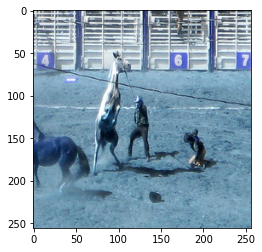

In [41]:
img_example = data_train.__getitem__(6)['A']
imshow(img_example.permute(1, 2, 0).detach().cpu().numpy())

In [42]:
img_list = []
counter = 0
for i in dataloader_train:
  img = i['A']
  if counter<=63:
    img_list.append(img[0])
  else:
    break
  counter+=1

In [43]:
img_list[1].shape

torch.Size([3, 256, 256])

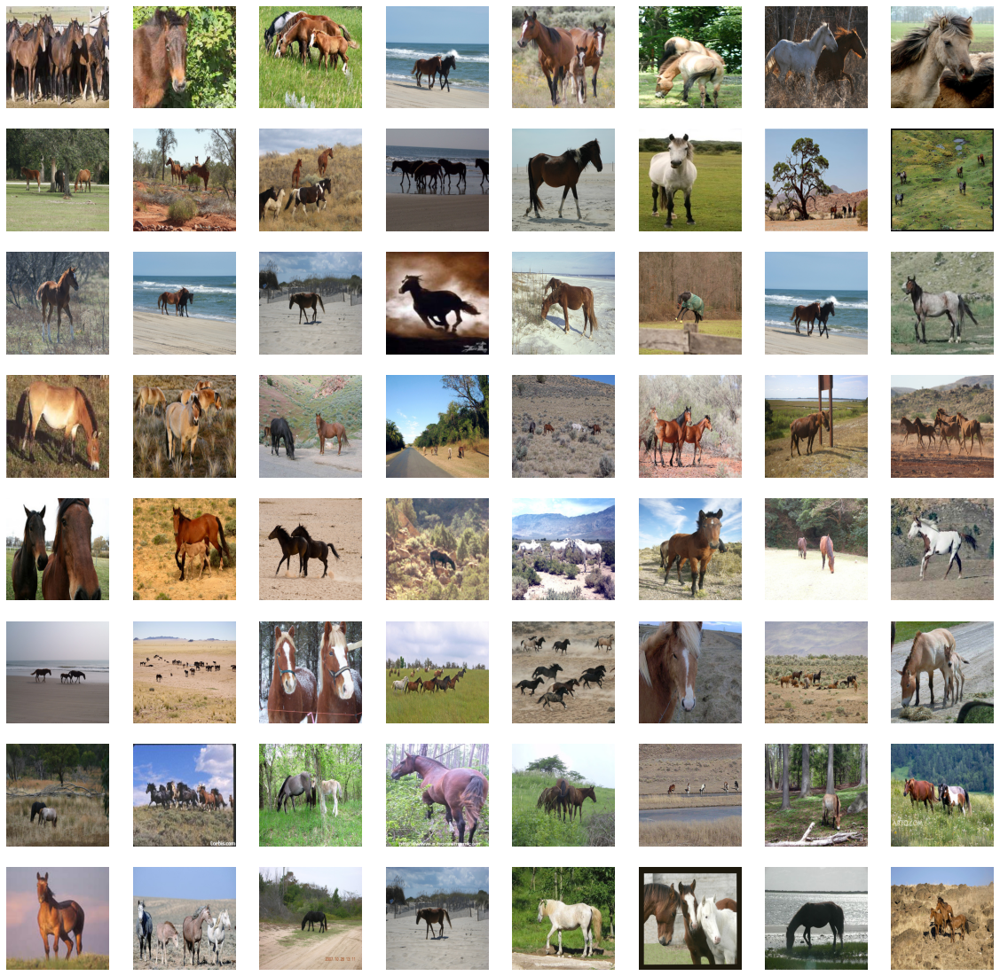

In [44]:
def show_many_examples(images, num_examples=64, figsize=(20, 20)):
  plt.figure(figsize=figsize)
  for k in range(num_examples):  
    plt.subplot(8, 8, k+1)
    plt.imshow(images[k].permute(1, 2, 0).detach().cpu().numpy())
    plt.axis('off')
  plt.show()
show_many_examples(img_list)

#Модель

In [45]:
class ResNetBlock(nn.Module):
  def __init__(self,input_f):
    super(ResNetBlock, self).__init__()
    self.main_block = nn.Sequential(
        nn.ReflectionPad2d(1),
        nn.Conv2d(input_f,input_f,3),
        nn.InstanceNorm2d(input_f),

        nn.ReLU(),
        
        nn.ReflectionPad2d(1),
        nn.Conv2d(input_f,input_f,3),
        nn.InstanceNorm2d(input_f)
    )
  def forward(self,x):
    return x+self.main_block(x)

In [46]:
class Generator1(nn.Module):
  def __init__(self,n_blocks=9):
    super(Generator1,self).__init__()
    
    #encoding

    self.encoding = nn.Sequential(
        nn.ReflectionPad2d(3), #1?
        nn.Conv2d(3, 64, kernel_size=7),
        nn.InstanceNorm2d(64),
        nn.ReLU(True),

        nn.Conv2d(64, 64*2, kernel_size=3, stride=2, padding=1),
        nn.InstanceNorm2d(64*2),
        nn.ReLU(True),

        nn.Conv2d(64*2, 64*4, kernel_size=3, stride=2, padding=1),
        nn.InstanceNorm2d(64),
        nn.ReLU(True)
    )

    #res Blocks
    for i in range(n_blocks):
      self.encoding = nn.Sequential(self.encoding, ResNetBlock(256))

    #decoding

    self.decoding = nn.Sequential(
        nn.ConvTranspose2d(64*4, 64*2, kernel_size=3, stride=2, padding=1, output_padding=1),
        nn.InstanceNorm2d(64*2),
        nn.ReLU(True),

        nn.ConvTranspose2d(64*2, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
        nn.InstanceNorm2d(64),
        nn.ReLU(True),

        nn.ReflectionPad2d(3),
        nn.Conv2d(64, 3, kernel_size=7),
        nn.Tanh()
    )
    self.model = nn.Sequential(self.encoding, self.decoding)

  def forward(self, x):
      return self.model(x)

In [48]:
class Discriminator1(nn.Module):
  def __init__(self):
    super(Discriminator1,self).__init__()
    self.model = nn.Sequential(
        nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
        nn.LeakyReLU(0.2),

        nn.Conv2d(64, 64*2, kernel_size=4, stride=2, padding=1),
        nn.InstanceNorm2d(64*2),
        nn.LeakyReLU(0.2),

        nn.Conv2d(64*2, 64*4, kernel_size=4, stride=2, padding=1),
        nn.InstanceNorm2d(64*4),
        nn.LeakyReLU(0.2),

        nn.Conv2d(64*4, 64*8, kernel_size=4, stride=1, padding=1),
        nn.InstanceNorm2d(64*2),
        nn.LeakyReLU(0.2),

        nn.Conv2d(64*8, 1, kernel_size=4, stride=1, padding=1)
    )
  def forward(self, x):
      return self.model(x)

In [50]:
class ImagePool():
  def __init__(self, pool_size = 50):
    self.pool_size = pool_size
    self.images = []
  def get_images(self, images):
    image_list = []
    for img in images:
      image = torch.unsqueeze(img.data, 0)
      if len(self.images) < self.pool_size:
        self.images.append(image)
        image_list.append(image)
      else:
        if random.uniform(0,1) > 0.5:
          i = random.randint(0, self.pool_size - 1)
          image_list.append(self.images[i].clone())
          self.images[i] = image
        else:
          image_list.append(image)
    return torch.cat(image_list)

In [51]:
def to_np(x):
    return x.data.cpu().numpy()

In [53]:
G_A2B = Generator1()
G_B2A = Generator1()
D_A = Discriminator1()
D_B = Discriminator1()

G_B2A.cuda()

D_B.cuda()
G_A2B.cuda()
D_A.cuda()

Discriminator1(
  (model): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (4): LeakyReLU(negative_slope=0.2)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (7): LeakyReLU(negative_slope=0.2)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
    (9): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (10): LeakyReLU(negative_slope=0.2)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
  )
)

In [54]:
criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

In [55]:
optimizer_G = torch.optim.Adam(itertools.chain(G_A2B.parameters(), G_B2A.parameters()),lr=2e-4, betas=(0.5, 0.999))
optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=2e-4, betas=(0.5, 0.999))
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=2e-4, betas=(0.5, 0.999))
scheduler = torch.optim.lr_scheduler.StepLR(optimizer_G, step_size=30, gamma=0.5)

In [56]:
fake_pull_A = ImagePool()
fake_pull_B = ImagePool()

#Тренировка модели 


In [57]:
def plot_train_result(real_image, gen_image, recon_image, epoch, fig_size=(8, 5)):
    fig, axes = plt.subplots(2, 3, figsize=fig_size)

    imgs = [to_np(real_image[0]), to_np(gen_image[0]), to_np(recon_image[0]),
            to_np(real_image[1]), to_np(gen_image[1]), to_np(recon_image[1])]
    for ax, img in zip(axes.flatten(), imgs):
        ax.axis('off')
        ax.set_adjustable('box')
        # Scale to 0-255
        img = img.squeeze()
        img = (((img - img.min()) * 255) / (img.max() - img.min())).transpose(1, 2, 0).astype(np.uint8)
        ax.imshow(img, cmap=None, aspect='equal')
    plt.subplots_adjust(wspace=0, hspace=0)

    title = 'Epoch {0}'.format(epoch + 1)
    fig.text(0.5, 0.04, title, ha='center', fontsize=12, color='white')

    plt.show()

In [58]:
def train(n_epochs):
    G_A2B.train()
    G_B2A.train()
    G_A_losses = []
    G_B_losses = []
    D_A_losses = []
    D_B_losses = []
    cycle_A_losses = []
    cycle_B_losses = []

    for epoch in tqdm(range(n_epochs)):
        G_A_loss = 0
        G_B_loss = 0
        D_A_loss = 0
        D_B_loss = 0
        cycle_A_loss = 0
        cycle_B_loss = 0

        for i, data in enumerate(dataloader_train):
            real_A = data['A'].to(device)
            real_B = data['B'].to(device)

            for param in D_A.parameters():
                param.requires_grad = False
            for param in D_B.parameters():
                param.requires_grad = False
            
            optimizer_G.zero_grad()        
            # Identity loss
            same_B = G_A2B(real_B)
            loss_identity_B = criterion_identity(same_B, real_B)*5.0

            same_A = G_B2A(real_A)
            loss_identity_A = criterion_identity(same_A, real_A)*5.0


            fake_B = G_A2B(real_A)
            pred_fake = D_B(fake_B)
            target_real = torch.tensor(1., device=device).expand_as(pred_fake)
            loss_GAN_A2B = criterion_GAN(pred_fake, target_real)

            fake_A = G_B2A(real_B)
            pred_fake = D_A(fake_A)
            loss_GAN_B2A = criterion_GAN(pred_fake, target_real)

            # Cycle loss
            rec_A = G_B2A(fake_B)
            loss_cycle_ABA = criterion_cycle(rec_A, real_A)*10.0

            rec_B = G_A2B(fake_A)
            loss_cycle_BAB = criterion_cycle(rec_B, real_B)*10.0

            # Total loss
            loss_G = loss_identity_A + loss_identity_B + loss_GAN_A2B + loss_GAN_B2A + loss_cycle_ABA + loss_cycle_BAB
            loss_G.backward()
            
            optimizer_G.step()

            for param in D_A.parameters():
                param.requires_grad = True
            for param in D_B.parameters():
                param.requires_grad = True

            # Discriminator A
            optimizer_D_A.zero_grad()

            # Real loss
            pred_real = D_A(real_A)
            loss_D_real = criterion_GAN(pred_real, target_real)

            # Fake loss
            fake_A = fake_pull_A.get_images(fake_A)
            pred_fake = D_A(fake_A.detach())
            target_fake = torch.tensor(0., device=device).expand_as(pred_fake)
            loss_D_fake = criterion_GAN(pred_fake, target_fake)

            # Total loss
            loss_D_A = (loss_D_real + loss_D_fake)*0.5
            loss_D_A.backward()

            optimizer_D_A.step()


            # Discriminator B
            optimizer_D_B.zero_grad()

            # Real loss
            pred_real = D_B(real_B)
            loss_D_real = criterion_GAN(pred_real, target_real)
            
            # Fake loss
            fake_B = fake_pull_B.get_images(fake_B)
            pred_fake = D_B(fake_B.detach())
            loss_D_fake = criterion_GAN(pred_fake, target_fake)

            # Total loss
            loss_D_B = (loss_D_real + loss_D_fake)*0.5
            loss_D_B.backward()

            optimizer_D_B.step()

            G_A_loss += loss_GAN_A2B.item()
            G_B_loss += loss_GAN_B2A.item()
            D_A_loss += loss_D_A.item()
            D_B_loss += loss_D_B.item()
            cycle_A_loss += loss_cycle_ABA.item()
            cycle_B_loss += loss_cycle_BAB.item()
        data_length = len(dataloader_train)
        G_A_losses.append(G_A_loss / data_length)
        G_B_losses.append(G_B_loss / data_length)
        D_A_losses.append(D_A_loss / data_length)
        D_B_losses.append(D_B_loss / data_length)
        cycle_A_losses.append(cycle_A_loss / data_length)
        cycle_B_losses.append(cycle_B_loss / data_length)


        print('Generator A loss: {}, Generator B loss: {}'.format(G_A_losses[-1], G_B_losses[-1]))
        print('Discr A loss: {}, Discr B loss: {}'.format(D_A_losses[-1], D_B_losses[-1]))
        print('Cycle A loss: {}, Cycle B loss: {}'.format(cycle_A_losses[-1], cycle_B_losses[-1]))

        test_real_A_2 = test_real_A_data_2.cuda()
        test_fake_B_2 = G_A2B(test_real_A_2)
        test_rec_A_2 = G_B2A(test_fake_B_2)

        test_real_B_2 = test_real_B_data_2.cuda()
        test_fake_A_2 = G_B2A(test_real_B_2)
        test_rec_B_2 = G_A2B(test_fake_A_2)
        plot_train_result([test_real_A_2, test_real_B_2], [test_fake_B_2, test_fake_A_2], [test_rec_A_2, test_rec_B_2], epoch)

        scheduler.step()
    return G_A_losses, G_B_losses, D_A_losses, D_B_losses, cycle_A_losses, cycle_B_losses

  0%|                                                                                                                      | 0/60 [00:00<?, ?it/s]

Generator A loss: 0.3761898430880536, Generator B loss: 0.3496476238112101
Discr A loss: 0.25115597529357736, Discr B loss: 0.2373466656114278
Cycle A loss: 1.361176940698302, Cycle B loss: 1.4874182619405596


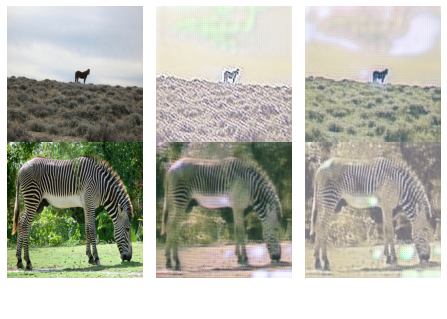

  2%|█▊                                                                                                         | 1/60 [07:39<7:32:17, 459.95s/it]

Generator A loss: 0.3597970150076271, Generator B loss: 0.3455329619892193
Discr A loss: 0.19578470107209817, Discr B loss: 0.18962692286861077
Cycle A loss: 1.1490649516662854, Cycle B loss: 1.2442405685949862


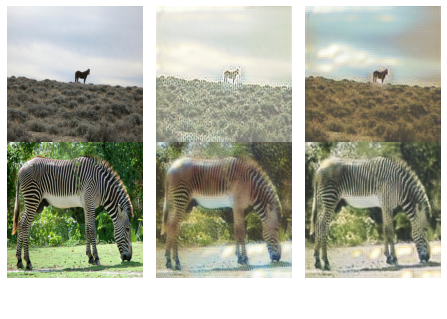

  3%|███▌                                                                                                       | 2/60 [15:12<7:20:09, 455.33s/it]

Generator A loss: 0.3911427307748393, Generator B loss: 0.3323724748755104
Discr A loss: 0.1928297837798515, Discr B loss: 0.18125086943252702
Cycle A loss: 1.0656685261244185, Cycle B loss: 1.1566565727919675


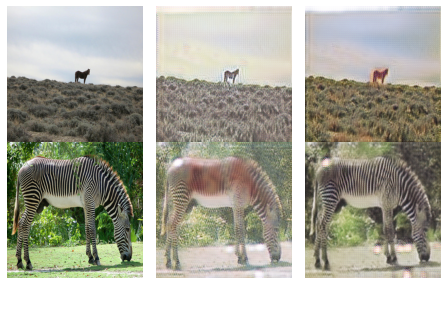

  5%|█████▎                                                                                                     | 3/60 [22:44<7:11:10, 453.86s/it]

Generator A loss: 0.38361746060212004, Generator B loss: 0.3083355420258608
Discr A loss: 0.19598596017347292, Discr B loss: 0.17721401928515917
Cycle A loss: 1.002019758036967, Cycle B loss: 1.0837917180543535


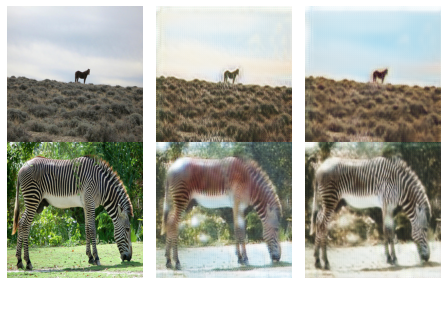

  7%|███████▏                                                                                                   | 4/60 [30:16<7:03:01, 453.25s/it]

Generator A loss: 0.41849103059326664, Generator B loss: 0.33244242788700573
Discr A loss: 0.19181968976607483, Discr B loss: 0.16516941662752227
Cycle A loss: 0.9756288832493043, Cycle B loss: 1.0486859889512652


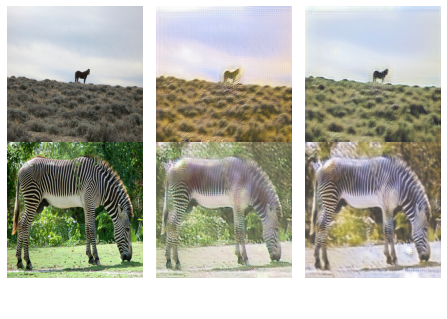

  8%|████████▉                                                                                                  | 5/60 [37:48<6:55:06, 452.85s/it]

Generator A loss: 0.4240154906772496, Generator B loss: 0.3309026729273662
Discr A loss: 0.18521268130855614, Discr B loss: 0.16363215704312487
Cycle A loss: 0.9788362595472443, Cycle B loss: 1.022220602196254


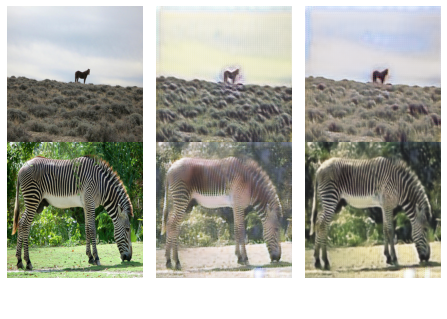

 10%|██████████▋                                                                                                | 6/60 [45:20<6:47:21, 452.62s/it]

Generator A loss: 0.41257286317897646, Generator B loss: 0.33899275637074805
Discr A loss: 0.18941024839040937, Discr B loss: 0.1631322263248181
Cycle A loss: 0.9407074538509498, Cycle B loss: 0.9790954687622156


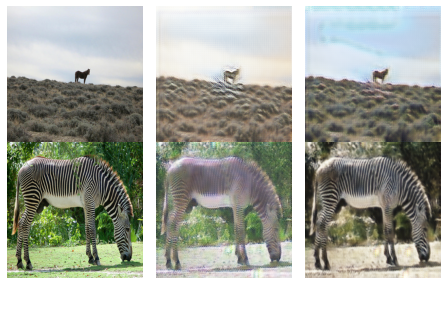

 12%|████████████▍                                                                                              | 7/60 [52:52<6:39:41, 452.47s/it]

Generator A loss: 0.39804041334584855, Generator B loss: 0.33390152089381486
Discr A loss: 0.19432736430945022, Discr B loss: 0.17344522602605017
Cycle A loss: 0.9040795827179813, Cycle B loss: 0.9478041322043772


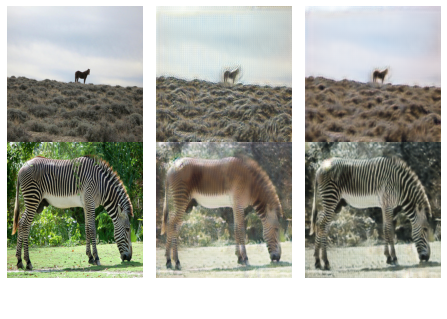

 13%|██████████████                                                                                           | 8/60 [1:00:25<6:32:02, 452.36s/it]

Generator A loss: 0.39326153677166176, Generator B loss: 0.3279858782301458
Discr A loss: 0.19669491560773902, Discr B loss: 0.17543855457660856
Cycle A loss: 0.8910823115472043, Cycle B loss: 0.9305820249439625


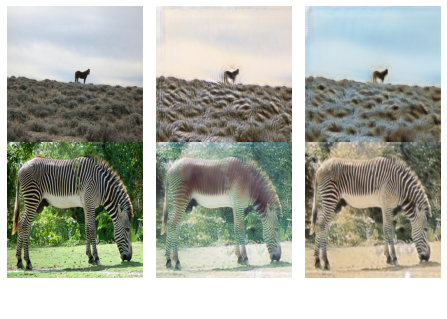

 15%|███████████████▊                                                                                         | 9/60 [1:07:57<6:24:28, 452.32s/it]

Generator A loss: 0.3836723214371151, Generator B loss: 0.32844394433280727
Discr A loss: 0.19061603795611456, Discr B loss: 0.17708238279551602
Cycle A loss: 0.8898624544733026, Cycle B loss: 0.9229892121272141


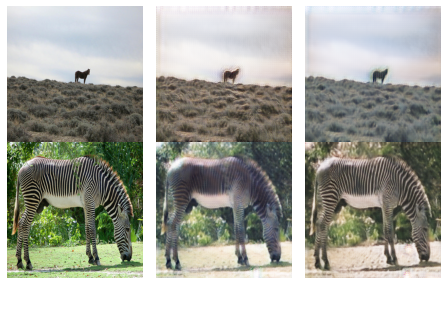

 17%|█████████████████▎                                                                                      | 10/60 [1:15:27<6:16:30, 451.81s/it]

Generator A loss: 0.38615722999478996, Generator B loss: 0.337024227144678
Discr A loss: 0.18939263601316494, Discr B loss: 0.1812374835519978
Cycle A loss: 0.8633857208021571, Cycle B loss: 0.8897869652576661


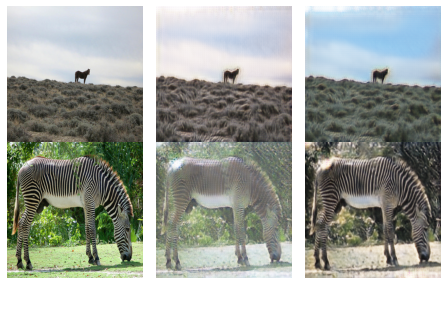

 18%|███████████████████                                                                                     | 11/60 [1:22:52<6:07:09, 449.58s/it]

Generator A loss: 0.39108536616804895, Generator B loss: 0.3389273357441586
Discr A loss: 0.18837653060307663, Discr B loss: 0.17766899229602867
Cycle A loss: 0.8657078150952799, Cycle B loss: 0.8902723548117648


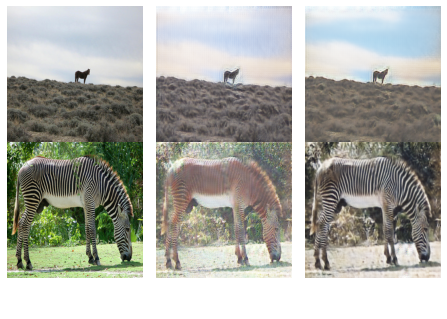

 20%|████████████████████▊                                                                                   | 12/60 [1:30:17<5:58:26, 448.05s/it]

Generator A loss: 0.38594578381502226, Generator B loss: 0.3388155695595098
Discr A loss: 0.18622376615746639, Discr B loss: 0.1800609096131298
Cycle A loss: 0.8541340787758988, Cycle B loss: 0.8815464915854208


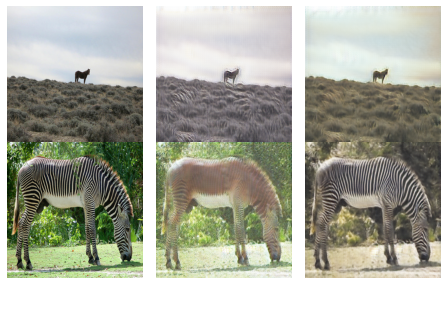

 22%|██████████████████████▌                                                                                 | 13/60 [1:37:41<5:50:10, 447.04s/it]

Generator A loss: 0.3869185336185305, Generator B loss: 0.3372208642658223
Discr A loss: 0.18933741108755048, Discr B loss: 0.17790564089343788
Cycle A loss: 0.8317446452848027, Cycle B loss: 0.8504679694604338


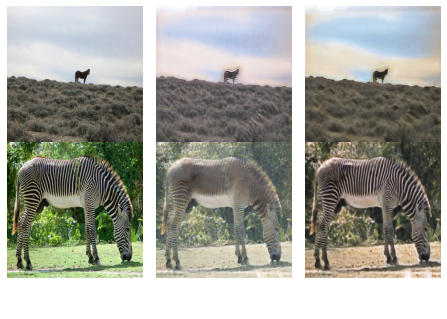

 23%|████████████████████████▎                                                                               | 14/60 [1:45:06<5:42:09, 446.29s/it]

Generator A loss: 0.3930526933978113, Generator B loss: 0.3368684426787194
Discr A loss: 0.18607150768296102, Discr B loss: 0.17567096220308476
Cycle A loss: 0.831349503592159, Cycle B loss: 0.8388784575998114


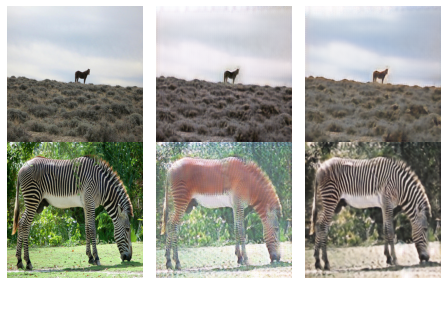

 25%|██████████████████████████                                                                              | 15/60 [1:52:30<5:34:19, 445.77s/it]

Generator A loss: 0.3721334365395348, Generator B loss: 0.34067258314972515
Discr A loss: 0.1851465905817707, Discr B loss: 0.17919914427767977
Cycle A loss: 0.8205737918950199, Cycle B loss: 0.8261400249566925


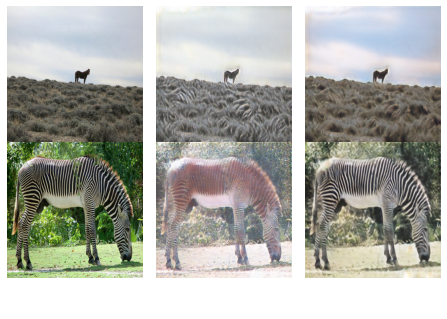

 27%|███████████████████████████▋                                                                            | 16/60 [1:59:55<5:26:38, 445.41s/it]

Generator A loss: 0.38412343454494907, Generator B loss: 0.3401773533710603
Discr A loss: 0.1863826053028696, Discr B loss: 0.17967044876030322
Cycle A loss: 0.8091522571745883, Cycle B loss: 0.8243759804897094


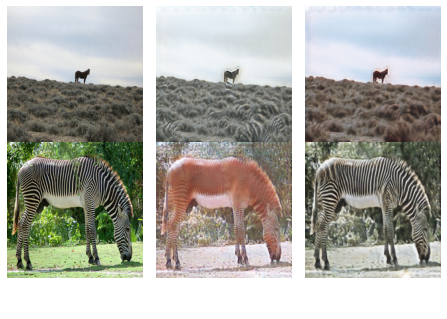

 28%|█████████████████████████████▍                                                                          | 17/60 [2:07:20<5:19:01, 445.15s/it]

Generator A loss: 0.38500870410980803, Generator B loss: 0.3537327992363592
Discr A loss: 0.18256323366017824, Discr B loss: 0.17628471747543034
Cycle A loss: 0.8095379754398646, Cycle B loss: 0.8199062110332961


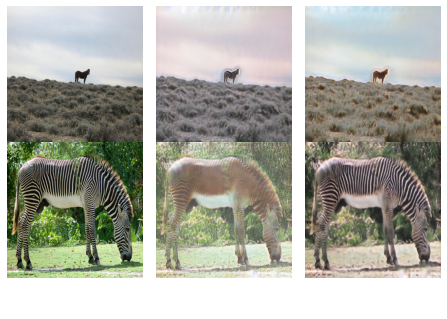

 30%|███████████████████████████████▏                                                                        | 18/60 [2:14:44<5:11:28, 444.97s/it]

Generator A loss: 0.398859857340877, Generator B loss: 0.3434549107059334
Discr A loss: 0.18057950825503702, Discr B loss: 0.17420416167947683
Cycle A loss: 0.8038227197829257, Cycle B loss: 0.8138898925834828


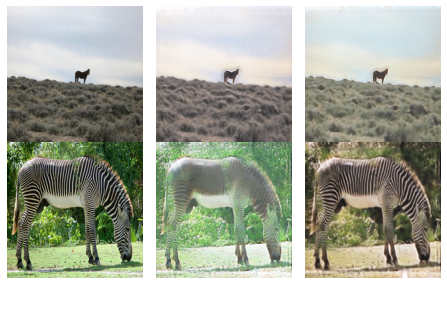

 32%|████████████████████████████████▉                                                                       | 19/60 [2:22:09<5:03:59, 444.87s/it]

Generator A loss: 0.38399993573011976, Generator B loss: 0.3557585506626729
Discr A loss: 0.18000148564074817, Discr B loss: 0.17193048293336055
Cycle A loss: 0.788539560591237, Cycle B loss: 0.7959852353910382


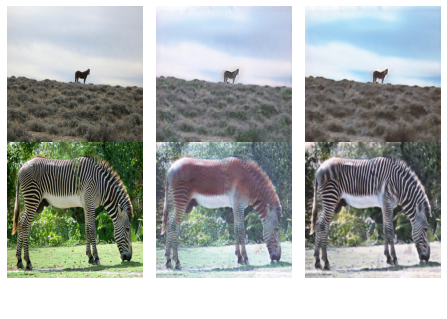

 33%|██████████████████████████████████▋                                                                     | 20/60 [2:29:34<4:56:34, 444.86s/it]

Generator A loss: 0.39027470170279566, Generator B loss: 0.3537161648273468
Discr A loss: 0.17715659468026643, Discr B loss: 0.17278563977124986
Cycle A loss: 0.7723531109563421, Cycle B loss: 0.797900067152602


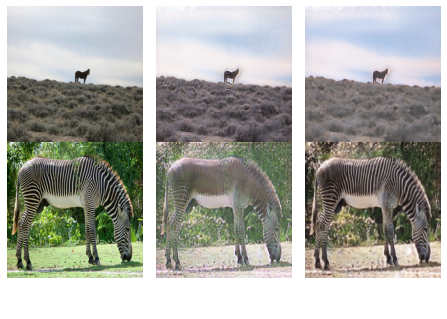

 35%|████████████████████████████████████▍                                                                   | 21/60 [2:36:58<4:49:06, 444.78s/it]

Generator A loss: 0.3919442512848404, Generator B loss: 0.3562354716901364
Discr A loss: 0.17194721396552043, Discr B loss: 0.17119651533914415
Cycle A loss: 0.7581831113676006, Cycle B loss: 0.7877838474311186


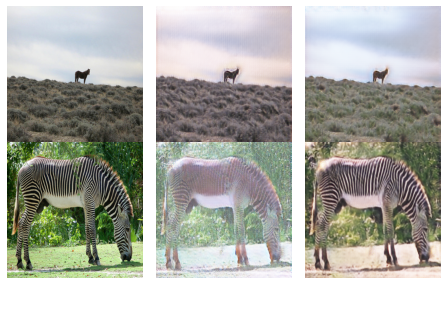

 37%|██████████████████████████████████████▏                                                                 | 22/60 [2:44:23<4:41:39, 444.73s/it]

Generator A loss: 0.3939212903966395, Generator B loss: 0.35194616096743037
Discr A loss: 0.18214647388190366, Discr B loss: 0.1767264762537533
Cycle A loss: 0.7509372689750757, Cycle B loss: 0.7625513139735447


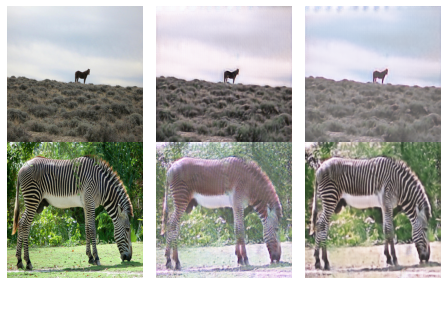

 38%|███████████████████████████████████████▊                                                                | 23/60 [2:51:47<4:34:12, 444.67s/it]

Generator A loss: 0.3928725046555648, Generator B loss: 0.35033675683348364
Discr A loss: 0.17625825654589727, Discr B loss: 0.17098288656620497
Cycle A loss: 0.7427243274919103, Cycle B loss: 0.7627660930826423


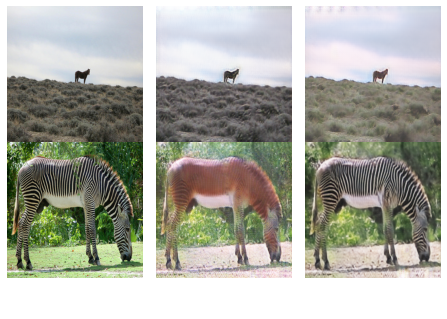

 40%|█████████████████████████████████████████▌                                                              | 24/60 [2:59:12<4:26:46, 444.63s/it]

Generator A loss: 0.38685146125263714, Generator B loss: 0.35484096348453104
Discr A loss: 0.17527428177300464, Discr B loss: 0.1723633794553494
Cycle A loss: 0.73784050707067, Cycle B loss: 0.7651399615105619


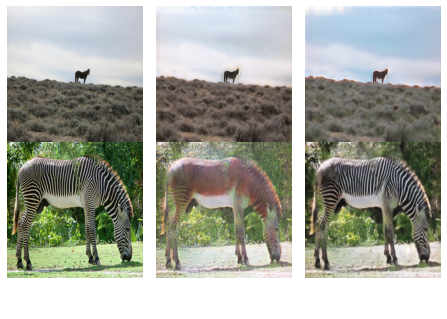

 42%|███████████████████████████████████████████▎                                                            | 25/60 [3:06:36<4:19:21, 444.62s/it]

Generator A loss: 0.3921663993278916, Generator B loss: 0.3588737414877736
Discr A loss: 0.17710092611024889, Discr B loss: 0.17087169566683555
Cycle A loss: 0.7280835113498602, Cycle B loss: 0.7561628053027593


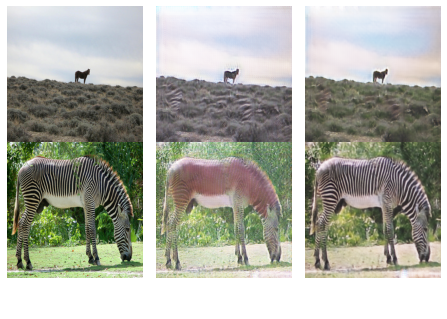

 43%|█████████████████████████████████████████████                                                           | 26/60 [3:14:01<4:11:55, 444.59s/it]

Generator A loss: 0.40102531315570467, Generator B loss: 0.36091357333941404
Discr A loss: 0.17594035793556256, Discr B loss: 0.1655348213954588
Cycle A loss: 0.729678780175327, Cycle B loss: 0.7525540206539497


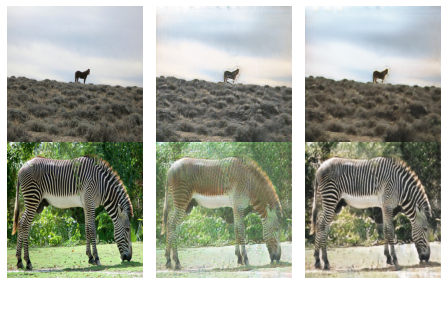

 45%|██████████████████████████████████████████████▊                                                         | 27/60 [3:21:25<4:04:31, 444.58s/it]

Generator A loss: 0.4062608854656809, Generator B loss: 0.34703604573949
Discr A loss: 0.1772405631840229, Discr B loss: 0.16377129212356686
Cycle A loss: 0.7193500490001078, Cycle B loss: 0.7360009978996234


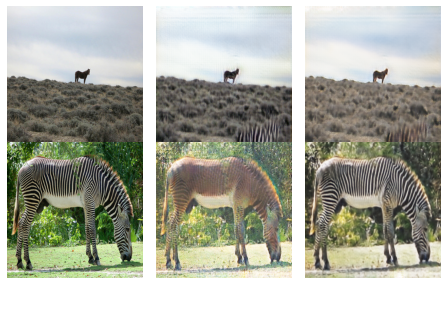

 47%|████████████████████████████████████████████████▌                                                       | 28/60 [3:28:50<3:57:07, 444.60s/it]

Generator A loss: 0.4074928465519059, Generator B loss: 0.35799861045533354
Discr A loss: 0.17689189894145793, Discr B loss: 0.16488841580373517
Cycle A loss: 0.7179672314209884, Cycle B loss: 0.7412864211570012


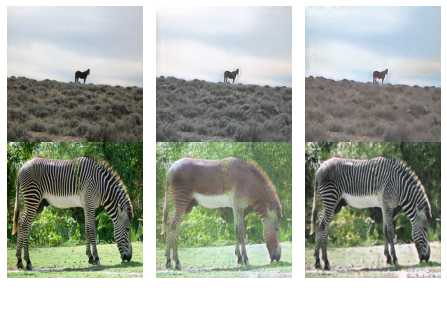

 48%|██████████████████████████████████████████████████▎                                                     | 29/60 [3:36:15<3:49:41, 444.56s/it]

Generator A loss: 0.4147441764560978, Generator B loss: 0.36316044494677124
Discr A loss: 0.17568971161427122, Discr B loss: 0.1587406773999166
Cycle A loss: 0.7089544673983971, Cycle B loss: 0.7261918168389395


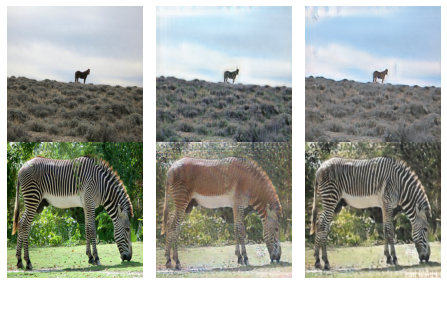

 50%|████████████████████████████████████████████████████                                                    | 30/60 [3:43:39<3:42:17, 444.57s/it]

Generator A loss: 0.42486922673127625, Generator B loss: 0.3680856068147702
Discr A loss: 0.17436670632509704, Discr B loss: 0.16274119382828808
Cycle A loss: 0.6251178910223286, Cycle B loss: 0.6604127849755662


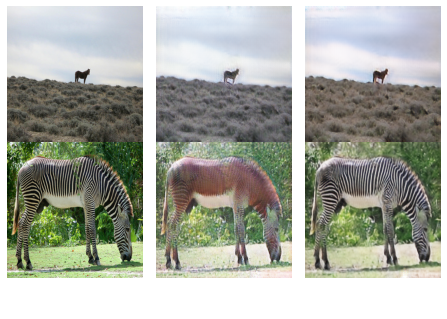

 52%|█████████████████████████████████████████████████████▋                                                  | 31/60 [3:51:04<3:34:52, 444.57s/it]

Generator A loss: 0.403035086845414, Generator B loss: 0.3719146348787158
Discr A loss: 0.17378272631027725, Discr B loss: 0.16753451192981741
Cycle A loss: 0.5988248242421097, Cycle B loss: 0.643564629219891


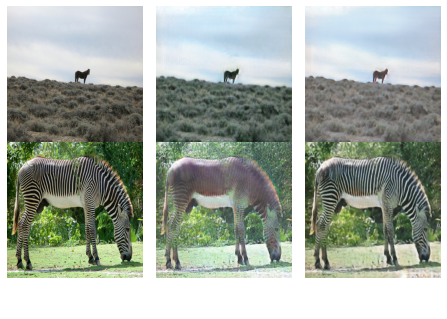

 53%|███████████████████████████████████████████████████████▍                                                | 32/60 [3:58:28<3:27:27, 444.55s/it]

Generator A loss: 0.41119308267416577, Generator B loss: 0.3707159668793169
Discr A loss: 0.17080255743492856, Discr B loss: 0.16764582368764985
Cycle A loss: 0.5936740427204732, Cycle B loss: 0.6413158866796601


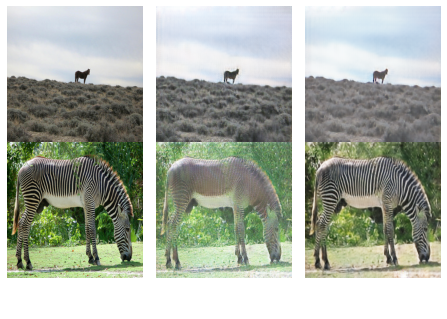

 55%|█████████████████████████████████████████████████████████▏                                              | 33/60 [4:05:53<3:20:03, 444.56s/it]

Generator A loss: 0.4228846752241756, Generator B loss: 0.39788784866922355
Discr A loss: 0.35125553021939954, Discr B loss: 0.15854500735576232
Cycle A loss: 0.6295978446355027, Cycle B loss: 0.6484885918290427


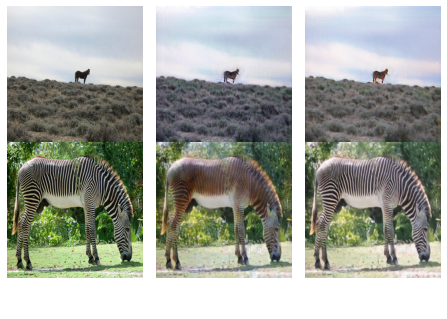

 57%|██████████████████████████████████████████████████████████▉                                             | 34/60 [4:13:17<3:12:39, 444.58s/it]

Generator A loss: 0.42584018041746, Generator B loss: 0.27337583434045987
Discr A loss: 0.24112860171982411, Discr B loss: 0.15703858976786056
Cycle A loss: 0.5848171194617668, Cycle B loss: 0.5850638137774521


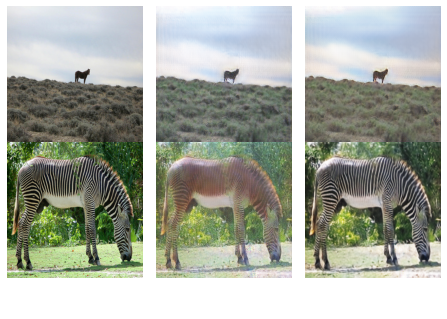

 58%|████████████████████████████████████████████████████████████▋                                           | 35/60 [4:20:42<3:05:14, 444.58s/it]

Generator A loss: 0.4273245317547509, Generator B loss: 0.27601020592317155
Discr A loss: 0.24103966221380768, Discr B loss: 0.15406065774935015
Cycle A loss: 0.5728840407360806, Cycle B loss: 0.564588487818


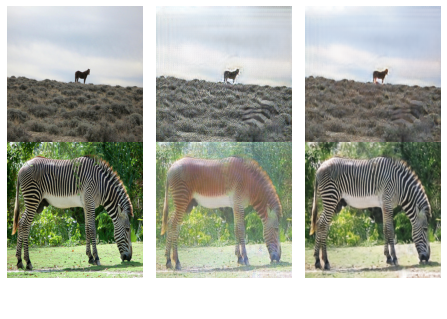

 60%|██████████████████████████████████████████████████████████████▍                                         | 36/60 [4:28:07<2:57:49, 444.57s/it]

Generator A loss: 0.4377547321359763, Generator B loss: 0.2808155966776141
Discr A loss: 0.23846863457995854, Discr B loss: 0.15448883238635705
Cycle A loss: 0.5605888059969698, Cycle B loss: 0.5550597707876999


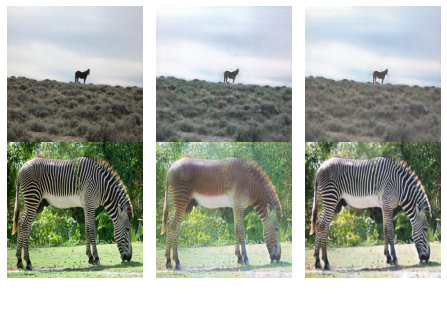

 62%|████████████████████████████████████████████████████████████████▏                                       | 37/60 [4:35:36<2:50:58, 446.00s/it]

Generator A loss: 0.43739129643091995, Generator B loss: 0.28989824140339754
Discr A loss: 0.23423357338048098, Discr B loss: 0.1523269760893302
Cycle A loss: 0.5581147756469383, Cycle B loss: 0.5511168192611652


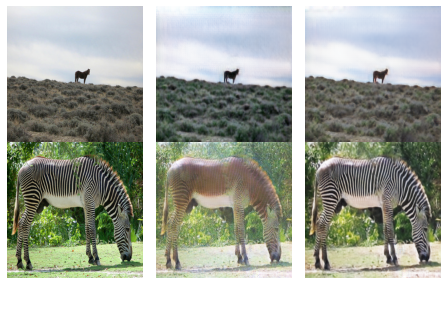

 63%|█████████████████████████████████████████████████████████████████▊                                      | 38/60 [4:43:06<2:44:00, 447.31s/it]

Generator A loss: 0.44509489763988536, Generator B loss: 0.3029653928755374
Discr A loss: 0.22660838767383876, Discr B loss: 0.14932096912787202
Cycle A loss: 0.5599166752247328, Cycle B loss: 0.5555884232681789


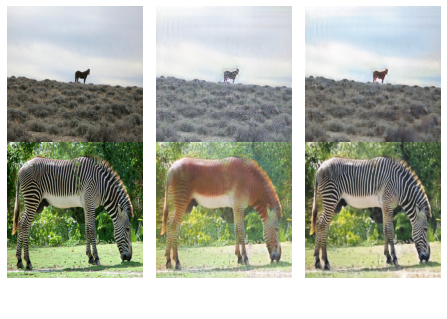

 65%|███████████████████████████████████████████████████████████████████▌                                    | 39/60 [4:50:31<2:36:16, 446.48s/it]

Generator A loss: 0.45369572744945463, Generator B loss: 0.32034183568164204
Discr A loss: 0.20870620733901357, Discr B loss: 0.14742828965019644
Cycle A loss: 0.556345281105363, Cycle B loss: 0.5645288178090299


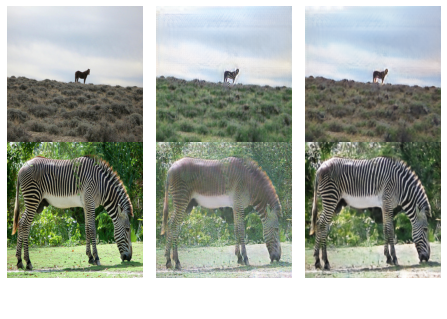

 67%|█████████████████████████████████████████████████████████████████████▎                                  | 40/60 [4:57:55<2:28:38, 445.92s/it]

Generator A loss: 0.45994507541482366, Generator B loss: 0.34152656677649934
Discr A loss: 0.19074205960450547, Discr B loss: 0.14453933258237464
Cycle A loss: 0.5524170756340027, Cycle B loss: 0.5811027911941656


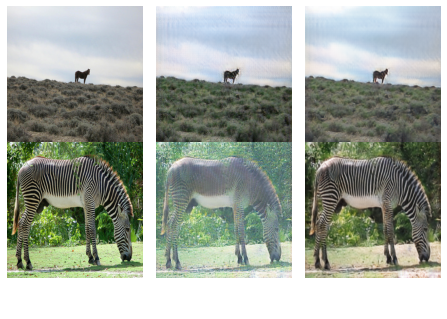

 68%|███████████████████████████████████████████████████████████████████████                                 | 41/60 [5:05:20<2:21:04, 445.49s/it]

Generator A loss: 0.4657873508300674, Generator B loss: 0.35196341945883935
Discr A loss: 0.17968776718284307, Discr B loss: 0.1478629809919368
Cycle A loss: 0.5480123426807061, Cycle B loss: 0.5830365478322747


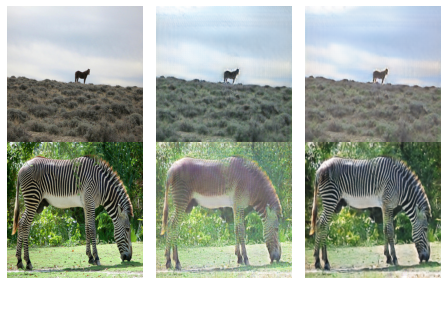

 70%|████████████████████████████████████████████████████████████████████████▊                               | 42/60 [5:12:45<2:13:33, 445.21s/it]

Generator A loss: 0.451488309562876, Generator B loss: 0.3649271877461605
Discr A loss: 0.17730136075046626, Discr B loss: 0.14728202489152384
Cycle A loss: 0.5433214243208424, Cycle B loss: 0.579339995946777


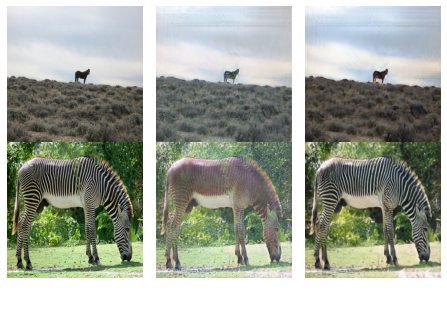

 72%|██████████████████████████████████████████████████████████████████████████▌                             | 43/60 [5:20:09<2:06:05, 445.03s/it]

Generator A loss: 0.45867839576153274, Generator B loss: 0.3628510412540329
Discr A loss: 0.17382173968499967, Discr B loss: 0.14541169530555104
Cycle A loss: 0.5420102410771873, Cycle B loss: 0.5784622260693754


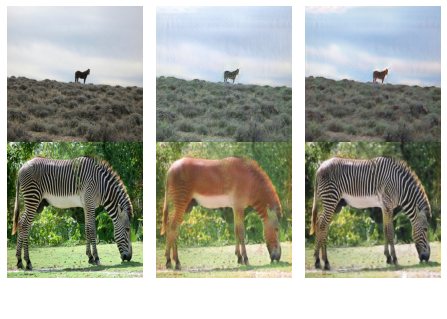

 73%|████████████████████████████████████████████████████████████████████████████▎                           | 44/60 [5:27:34<1:58:38, 444.89s/it]

Generator A loss: 0.4643901695863584, Generator B loss: 0.38037064375167484
Discr A loss: 0.1693735022558255, Discr B loss: 0.14592881005131797
Cycle A loss: 0.5442632424697448, Cycle B loss: 0.5810016874516948


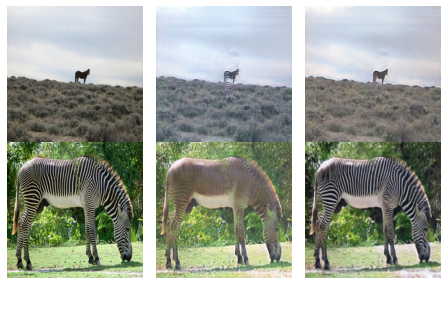

 75%|██████████████████████████████████████████████████████████████████████████████                          | 45/60 [5:34:58<1:51:11, 444.79s/it]

Generator A loss: 0.46976739384150235, Generator B loss: 0.3811180035049996
Discr A loss: 0.16997640320424284, Discr B loss: 0.14135088908873247
Cycle A loss: 0.5351724668165271, Cycle B loss: 0.5766357956307657


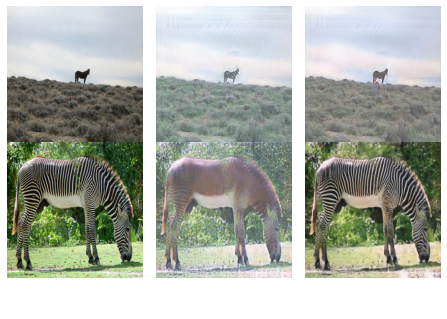

 77%|███████████████████████████████████████████████████████████████████████████████▋                        | 46/60 [5:42:23<1:43:46, 444.73s/it]

Generator A loss: 0.47150308613696795, Generator B loss: 0.39051252722405316
Discr A loss: 0.16611217194226352, Discr B loss: 0.13846880564194047
Cycle A loss: 0.5397588077555882, Cycle B loss: 0.5796117943994115


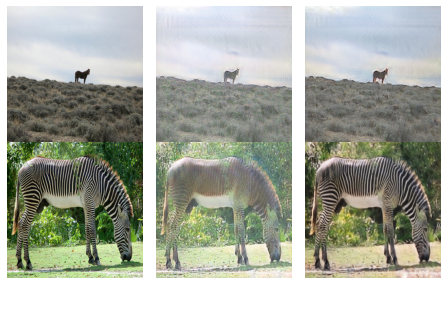

 78%|█████████████████████████████████████████████████████████████████████████████████▍                      | 47/60 [5:49:47<1:36:20, 444.67s/it]

Generator A loss: 0.47301303690738894, Generator B loss: 0.38590245973528103
Discr A loss: 0.16388823379961293, Discr B loss: 0.1406669470115324
Cycle A loss: 0.5292976151691394, Cycle B loss: 0.578169123845154


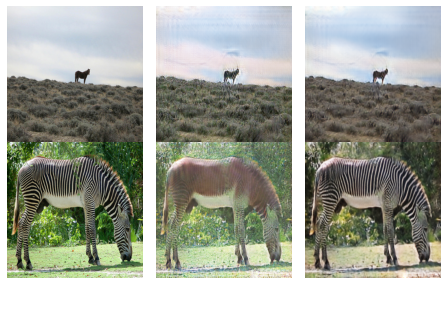

 80%|███████████████████████████████████████████████████████████████████████████████████▏                    | 48/60 [5:57:12<1:28:55, 444.65s/it]

Generator A loss: 0.47919253986538124, Generator B loss: 0.38997002937150804
Discr A loss: 0.162592580010382, Discr B loss: 0.14274344110254492
Cycle A loss: 0.5295061179761137, Cycle B loss: 0.5695206032040414


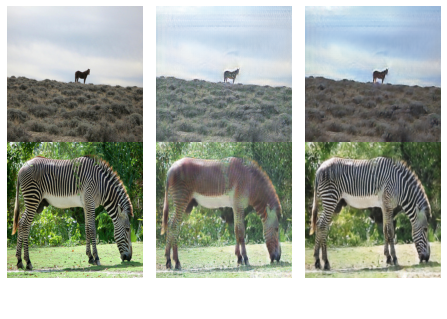

 82%|████████████████████████████████████████████████████████████████████████████████████▉                   | 49/60 [6:04:37<1:21:30, 444.63s/it]

Generator A loss: 0.4794889309767927, Generator B loss: 0.40521854699662563
Discr A loss: 0.16014062770631876, Discr B loss: 0.13846540940778979
Cycle A loss: 0.5257263991939888, Cycle B loss: 0.5726023370630285


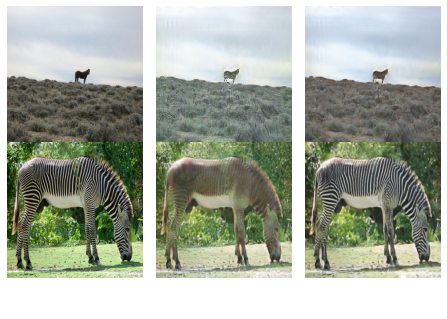

 83%|██████████████████████████████████████████████████████████████████████████████████████▋                 | 50/60 [6:12:01<1:14:06, 444.60s/it]

Generator A loss: 0.4844647116875381, Generator B loss: 0.40426100554426064
Discr A loss: 0.1581411284174812, Discr B loss: 0.1364955323130897
Cycle A loss: 0.5248649834247118, Cycle B loss: 0.5753534385327542


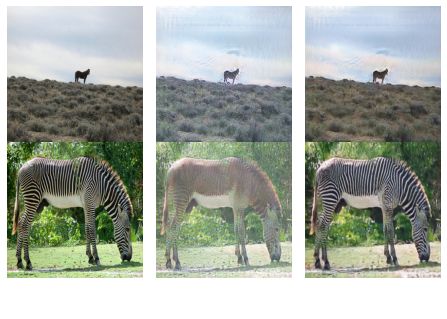

 85%|████████████████████████████████████████████████████████████████████████████████████████▍               | 51/60 [6:19:26<1:06:41, 444.59s/it]

Generator A loss: 0.4808593497852261, Generator B loss: 0.4005666166041674
Discr A loss: 0.15802941596909856, Discr B loss: 0.13704647399233968
Cycle A loss: 0.5187552798330114, Cycle B loss: 0.5692775666713714


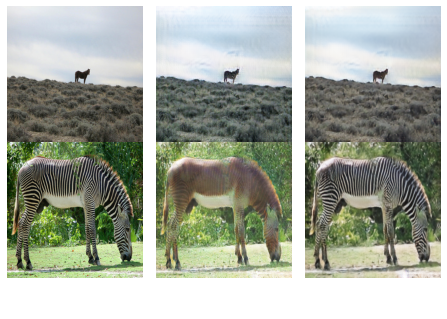

 87%|███████████████████████████████████████████████████████████████████████████████████████████▊              | 52/60 [6:26:50<59:16, 444.60s/it]

Generator A loss: 0.48948414735914614, Generator B loss: 0.41130794363745143
Discr A loss: 0.1556534962707691, Discr B loss: 0.13712554390678244
Cycle A loss: 0.5213987979996071, Cycle B loss: 0.5683684515149405


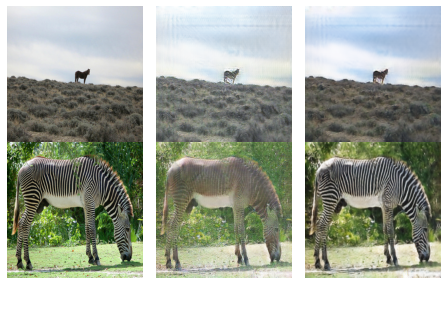

 88%|█████████████████████████████████████████████████████████████████████████████████████████████▋            | 53/60 [6:34:15<51:52, 444.59s/it]

Generator A loss: 0.5086840968453482, Generator B loss: 0.3994768745778652
Discr A loss: 0.4264458789751771, Discr B loss: 0.13209603447257803
Cycle A loss: 0.5713250349746661, Cycle B loss: 0.592573442485895


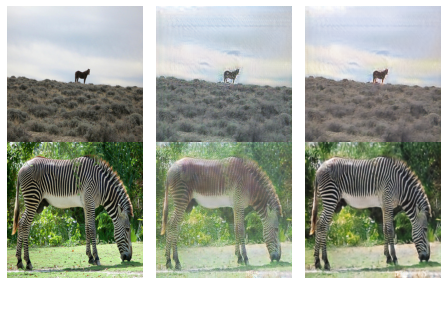

 90%|███████████████████████████████████████████████████████████████████████████████████████████████▍          | 54/60 [6:41:39<44:27, 444.59s/it]

Generator A loss: 0.4884381757693344, Generator B loss: 0.27633150718855054
Discr A loss: 0.2382329168614377, Discr B loss: 0.13633278754822323
Cycle A loss: 0.5222583037413908, Cycle B loss: 0.5107481365793207


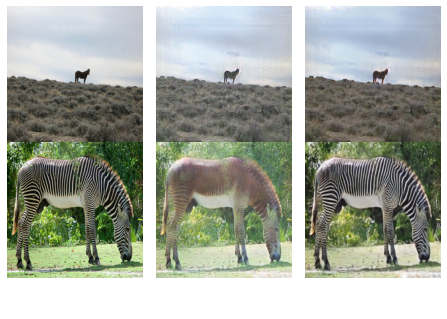

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████▏        | 55/60 [6:49:04<37:03, 444.60s/it]

Generator A loss: 0.4964036044779788, Generator B loss: 0.2879264807433225
Discr A loss: 0.23011378746354177, Discr B loss: 0.1326402316267571
Cycle A loss: 0.5121265402000942, Cycle B loss: 0.5050443620494243


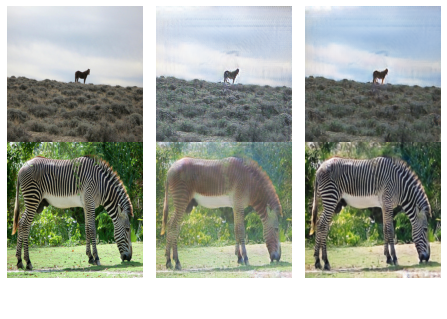

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████▉       | 56/60 [6:56:29<29:38, 444.58s/it]

Generator A loss: 0.4935626026787115, Generator B loss: 0.3012356170442667
Discr A loss: 0.21951435127954805, Discr B loss: 0.13876732395271238
Cycle A loss: 0.5090864448734883, Cycle B loss: 0.5010778888557734


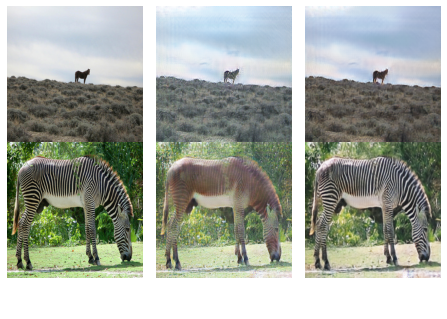

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 57/60 [7:03:53<22:13, 444.56s/it]

Generator A loss: 0.4938687903157781, Generator B loss: 0.32513936950584477
Discr A loss: 0.20304235477795762, Discr B loss: 0.13442781607756454
Cycle A loss: 0.5121312922306275, Cycle B loss: 0.5080115023623691


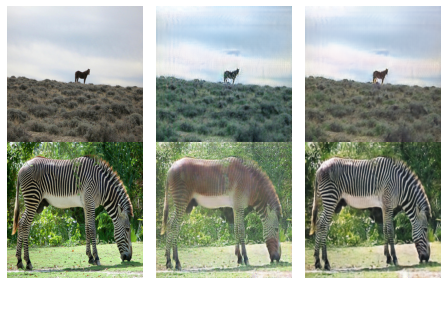

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 58/60 [7:11:18<14:49, 444.58s/it]

Generator A loss: 0.4934114204029019, Generator B loss: 0.35381273833218585
Discr A loss: 0.18506078946121624, Discr B loss: 0.1357167328676481
Cycle A loss: 0.5112319894051284, Cycle B loss: 0.5302297628997417


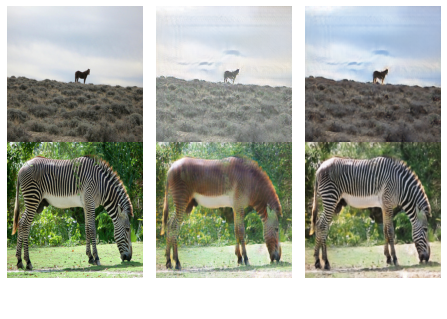

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 59/60 [7:18:42<07:24, 444.56s/it]

Generator A loss: 0.5064039901736077, Generator B loss: 0.37237971155496125
Discr A loss: 0.17339941202924491, Discr B loss: 0.13414806074808153
Cycle A loss: 0.5123724281787873, Cycle B loss: 0.5386909591347984


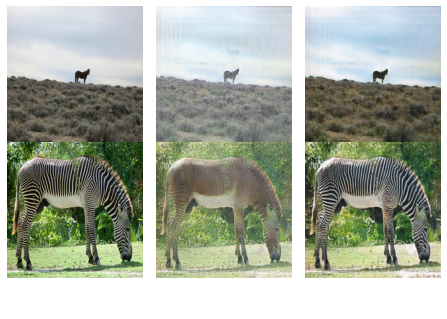

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████| 60/60 [7:26:07<00:00, 446.12s/it]


In [59]:
G_A_loss, G_B_loss, D_A_loss, D_B_loss, cycle_A_loss, cycle_B_loss = train(60)

In [64]:
loss_list = []
loss_list.append(G_A_loss)
loss_list.append(G_B_loss)
loss_list.append(D_A_loss)
loss_list.append(D_B_loss)
loss_list.append(cycle_A_loss)
loss_list.append(cycle_B_loss)


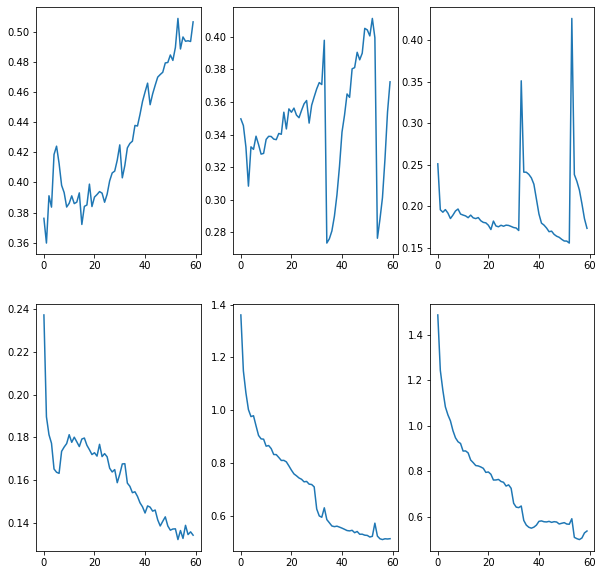

In [71]:
plt.figure(figsize=(10,10))
for k in range(len(loss_list)):  
  plt.subplot(2, 3, k+1)
  plt.plot(loss_list[k])

Как и ожидалось, лосс генераторов сначала падает, но потом начинает расти. Лосс дескриминаторов падает

In [60]:
def plot_test_result(test_images, length, test_class, fig_size=(20, 10)):
    fig, axes = plt.subplots(length // 5, length // (length // 5), figsize=fig_size)
    

    for ax, img in zip(axes.flatten(), test_images):
        ax.axis('off')
        ax.set_adjustable('box')
        ax.imshow(img, cmap=None, aspect='equal')
    plt.subplots_adjust(wspace=0, hspace=0)

    if test_class == 'A':
        title = 'Horse 2 zebra'.format(test_class)
        fig.text(0.5, 0.04, title, ha='center', fontsize=12, color='white')
    if test_class == 'B':
        title = 'Zebra 2 horse'.format(test_class)
        fig.text(0.5, 0.04, title, ha='center', fontsize=12, color='white')

    plt.show()

In [61]:
import sys

G_A2B.eval()
G_B2A.eval()
test_A = []
test_B = []

for i, batch in enumerate(dataloader_test):
    real_A = batch['A'].to(device)
    real_B = batch['B'].to(device)

    with torch.no_grad():
        fake_B = to_np(G_A2B(real_A))
        fake_A = to_np(G_B2A(real_B))

        fake_B = fake_B.squeeze()
        fake_B = (((fake_B - fake_B.min()) * 255) / (fake_B.max() - fake_B.min())).transpose(1, 2, 0).astype(np.uint8)
        test_B.append(fake_B)
        fake_B = Image.fromarray(fake_B)

        fake_A = fake_A.squeeze()
        fake_A = (((fake_A - fake_A.min()) * 255) / (fake_A.max() - fake_A.min())).transpose(1, 2, 0).astype(np.uint8)
        test_A.append(fake_A)
        fake_A = Image.fromarray(fake_A)

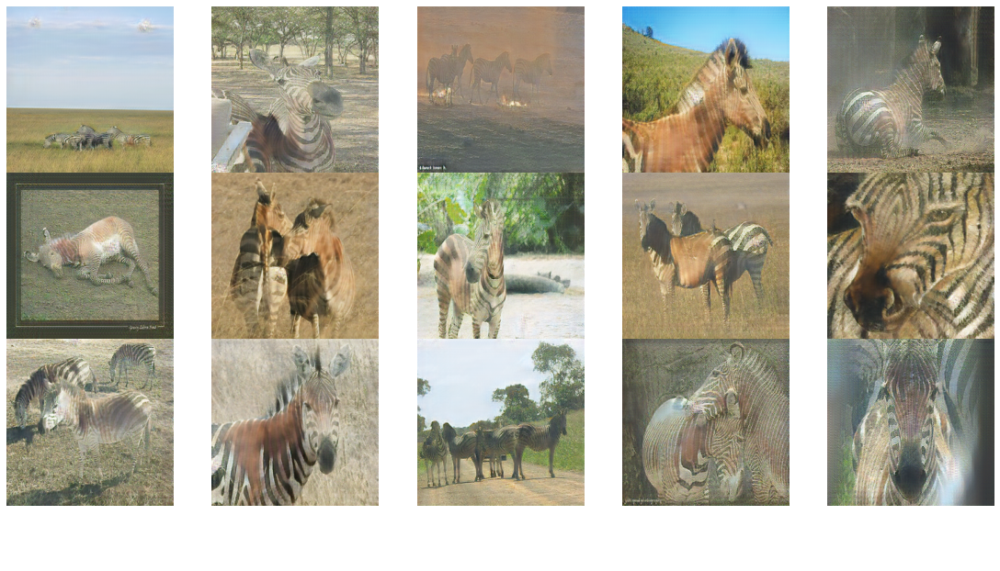

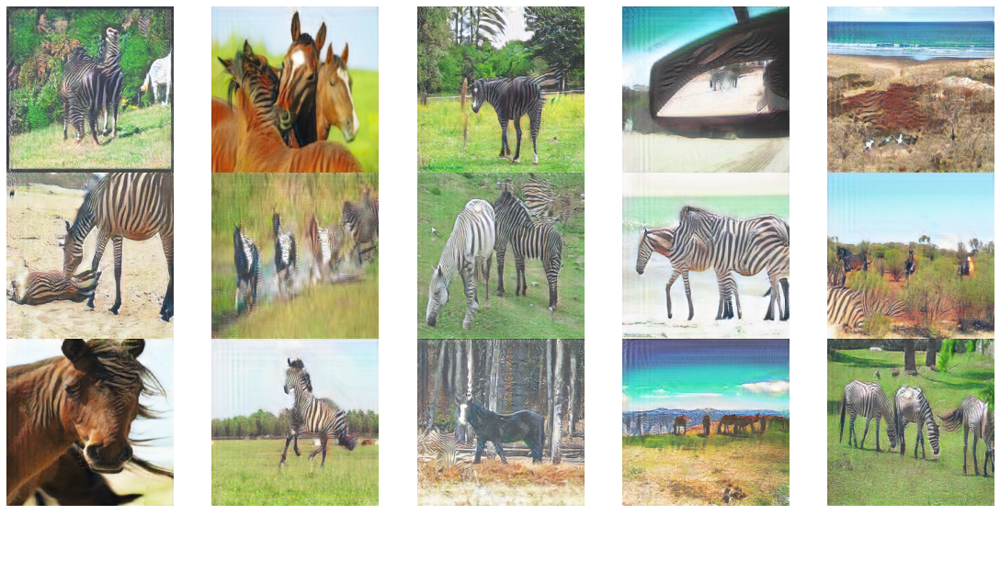

In [62]:
plot_test_result(test_A, 16, 'A')
plot_test_result(test_B, 16, 'B')

#Выводы/комментарии:

horse2zebra - 3й датасет, который я пробую в этой задаче. Сначала я пробовал датасет dog2cat, но результат получился плохой (только потом я заметил, что авторы оригинальной статьи сами предупреждали о том, что результаты с такими данными получаются плохими). Так же я пробовал cat2tiger, но результат тоже получился плохим. 

По итогу использовал датасет horse2zebra, обучал модель 60 эпох и, в принципе, результат получился похожим на результат авторов статьи на этом датасете.

#Использовал материалы:

https://towardsdatascience.com/cycle-gan-with-pytorch-ebe5db947a99

https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix

https://arxiv.org/abs/1703.10593